<a href="https://colab.research.google.com/github/nadiasuweer4ya/TumorVision-Intelligent-Brain-Tumor-Analysis-and-Segmentation/blob/main/Visualization_Nifti_and_DICOM_Files.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 11.3 MB/s eta 0:00:00


In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d sandorkonya/ct-lung-heart-trachea-segmentation
!kaggle datasets download -d awsaf49/brats20-dataset-training-validation
!kaggle competitions download -c trends-assessment-prediction

 99% 75.0M/75.4M [00:02<00:00, 43.3MB/s]
100% 75.4M/75.4M [00:02<00:00, 30.4MB/s]
100% 4.16G/4.16G [01:53<00:00, 44.0MB/s]
100% 4.16G/4.16G [01:53<00:00, 39.4MB/s]
100% 77.9k/77.9k [00:00<00:00, 774kB/s]
100% 77.9k/77.9k [00:00<00:00, 772kB/s]


In [ ]:
!unzip trends-assessment-prediction
!unzip brats20-dataset-training-validation
!unzip ct-lung-heart-trachea-segmentation

Archive:  trends-assessment-prediction.zip
  inflating: sample_submission.csv   
Archive:  brats20-dataset-training-validation.zip
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_flair.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_seg.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1ce.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t2.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_Training_002_flair.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_Training_002_seg.nii  
  inflating: BraTS2020_TrainingData/MICC

In [ ]:
!pip install pynrrd

In [ ]:
!pip install pydicom

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 14.2 MB/s eta 0:00:00


In [ ]:
!pip install nilearn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 34.6 MB/s eta 0:00:00


In [ ]:
from tqdm import tqdm
import os
from random import randint

import numpy as np
import pandas as pd

import nibabel as nib
import pydicom as pdm
import nilearn as nl
import nilearn.plotting as nlplt
import nrrd
import h5py

import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib.animation as anim

import imageio
from skimage.transform import resize
from skimage.util import montage

from IPython.display import Image as show_gif

import warnings
warnings.simplefilter("ignore")

# **Nifti File**

In [ ]:
class ImageToGIF:
    def __init__(self,
                 size=(600, 400),
                 xy_text=(80, 10),
                 dpi=100,
                 cmap='CMRmap'):

        self.fig = plt.figure()
        self.fig.set_size_inches(size[0] / dpi, size[1] / dpi)
        self.xy_text = xy_text
        self.cmap = cmap

        self.ax = self.fig.add_axes([0, 0, 1, 1])
        self.ax.set_xticks([])
        self.ax.set_yticks([])
        self.images = []

    def add(self, *args, label, with_mask=True):

        image = args[0]
        mask = args[-1]
        plt.set_cmap(self.cmap)
        plt_img = self.ax.imshow(image, animated=True)
        if with_mask:
            plt_mask = self.ax.imshow(np.ma.masked_where(mask == False, mask),
                                      alpha=0.7, animated=True)

        plt_text = self.ax.text(*self.xy_text, label, color='red')
        to_plot = [plt_img, plt_mask, plt_text] if with_mask else [plt_img, plt_text]
        self.images.append(to_plot)
        plt.close()

    def save(self, filename, fps):
        animation = anim.ArtistAnimation(self.fig, self.images)
        animation.save(filename, writer='imagemagick', fps=fps)


class Image3dToGIF3d:
    def __init__(self,
                 img_dim: tuple = (55, 55, 55),
                 figsize: tuple = (15, 10),
                ):
        self.img_dim = img_dim
        self.figsize = figsize

    def _explode(self, data: np.ndarray):
        shape_arr = np.array(data.shape)
        size = shape_arr[:3] * 2 - 1
        exploded = np.zeros(np.concatenate([size, shape_arr[3:]]),
                            dtype=data.dtype)
        exploded[::2, ::2, ::2] = data
        return exploded

    def _expand_coordinates(self, indices: np.ndarray):
        x, y, z = indices
        x[1::2, :, :] += 1
        y[:, 1::2, :] += 1
        z[:, :, 1::2] += 1
        return x, y, z

    def _normalize(self, arr: np.ndarray):
        return arr / arr.max()

    def _scale_by(self, arr: np.ndarray, factor: int):
        mean = np.mean(arr)
        return (arr - mean) * factor + mean

    def get_transformed_data(self, data: np.ndarray):
        norm_data = np.clip(self._normalize(data)-0.1, 0, 1) ** 0.4
        scaled_data = np.clip(self._scale_by(norm_data, 2) - 0.1, 0, 1)
        resized_data = resize(scaled_data, self.img_dim, mode='constant')
        return resized_data

    def plot_cube(self,
                  cube,
                  title: str = '',
                  init_angle: int = 0,
                  make_gif: bool = False,
                  path_to_save: str = 'filename.gif'
                 ):
        cube = self._normalize(cube)

        facecolors = cm.gist_stern(cube)
        facecolors[:,:,:,-1] = cube
        facecolors = self._explode(facecolors)

        filled = facecolors[:,:,:,-1] != 0
        x, y, z = self._expand_coordinates(np.indices(np.array(filled.shape) + 1))

        with plt.style.context("dark_background"):

            fig = plt.figure(figsize=self.figsize)
            ax = fig.gca(projection='3d')

            ax.view_init(30, init_angle)
            ax.set_xlim(right = self.img_dim[0] * 2)
            ax.set_ylim(top = self.img_dim[1] * 2)
            ax.set_zlim(top = self.img_dim[2] * 2)
            ax.set_title(title, fontsize=18, y=1.05)

            ax.voxels(x, y, z, filled, facecolors=facecolors, shade=False)

            if make_gif:
                images = []
                for angle in tqdm(range(0, 360, 5)):
                    ax.view_init(30, angle)
                    fname = str(angle) + '.png'

                    plt.savefig(fname, dpi=120, format='png', bbox_inches='tight')
                    images.append(imageio.imread(fname))
                imageio.mimsave(path_to_save, images)
                plt.close()

            else:
                plt.show()

In [ ]:
sample_filename = '/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_011/BraTS20_Training_011_flair.nii'
sample_filename_mask = '/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_011/BraTS20_Training_011_seg.nii'

sample_img = nib.load(sample_filename)
sample_img = np.asanyarray(sample_img.dataobj)
sample_mask = nib.load(sample_filename_mask)
sample_mask = np.asanyarray(sample_mask.dataobj)
print("img shape ->", sample_img.shape)
print("mask shape ->", sample_mask.shape)

img shape -> (240, 240, 155)
mask shape -> (240, 240, 155)


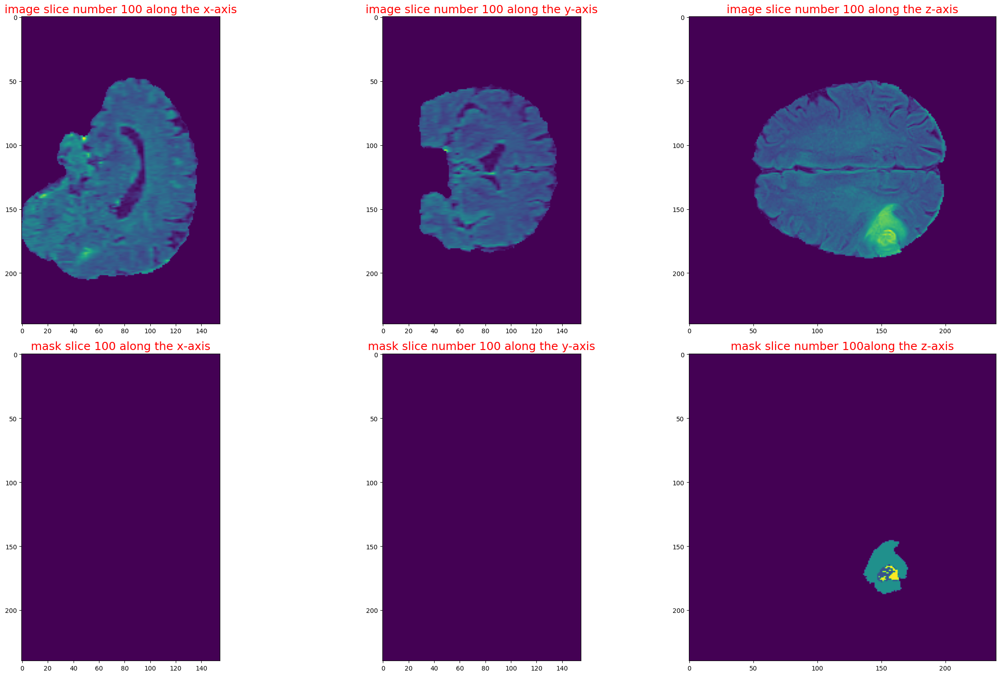

In [ ]:
slice_n = 100
fig, ax = plt.subplots(2, 3, figsize=(25, 15))

ax[0, 0].imshow(sample_img[slice_n, :, :])
ax[0, 0].set_title(f"image slice number {slice_n} along the x-axis", fontsize=18, color="red")
ax[1, 0].imshow(sample_mask[slice_n, :, :])
ax[1, 0].set_title(f"mask slice {slice_n} along the x-axis", fontsize=18, color="red")

ax[0, 1].imshow(sample_img[:, slice_n, :])
ax[0, 1].set_title(f"image slice number {slice_n} along the y-axis", fontsize=18, color="red")
ax[1, 1].imshow(sample_mask[:, slice_n, :])
ax[1, 1].set_title(f"mask slice number {slice_n} along the y-axis", fontsize=18, color="red")

ax[0, 2].imshow(sample_img[:, :, slice_n])
ax[0, 2].set_title(f"image slice number {slice_n} along the z-axis", fontsize=18, color="red")
ax[1, 2].imshow(sample_mask[:, :, slice_n])
ax[1, 2].set_title(f"mask slice number {slice_n}along the z-axis", fontsize=18, color="red")
fig.tight_layout()
plt.show()

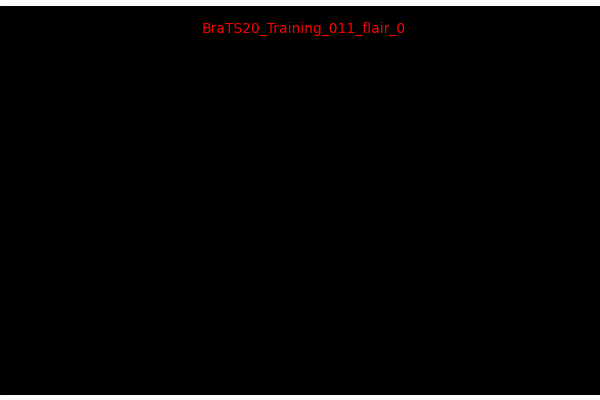

In [ ]:
sample_data_gif = ImageToGIF()
label = sample_filename.replace('/', '.').split('.')[-2]
filename = f'{label}_3d_2d.gif'

for i in range(sample_img.shape[0]):
    image = np.rot90(sample_img[i])
    mask = np.clip(np.rot90(sample_mask[i]), 0, 1)
    sample_data_gif.add(image, mask, label=f'{label}_{str(i)}')

sample_data_gif.save(filename, fps=15)
show_gif(filename, format='png')

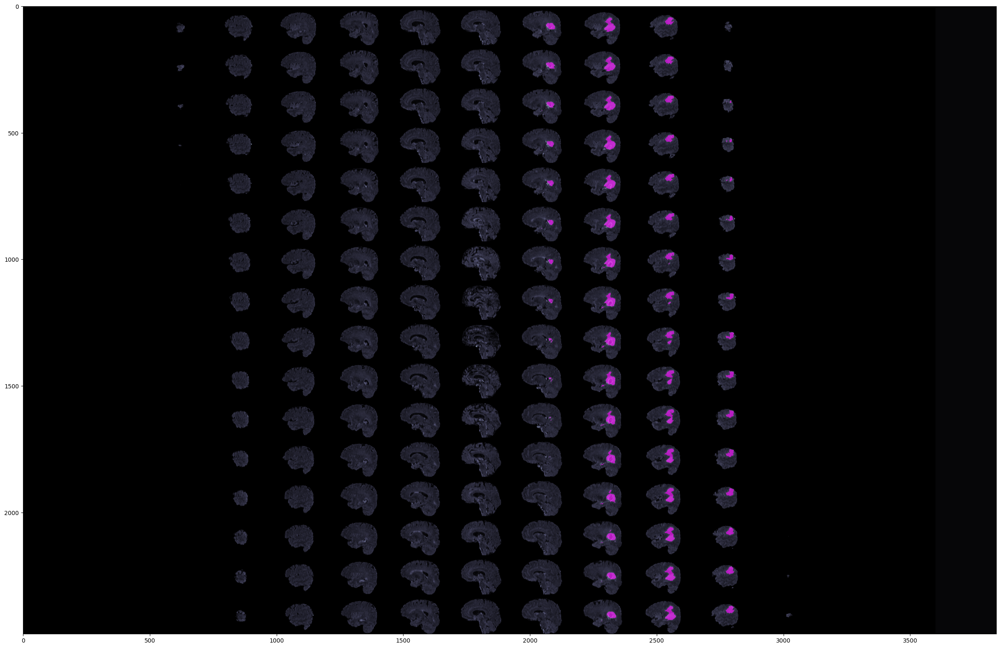

In [ ]:
image = np.rot90(montage(sample_img))
mask = np.rot90(montage(sample_mask))
mask = np.clip(mask, 0, 1)

fig, ax1 = plt.subplots(1, 1, figsize = (30, 30))
ax1.imshow(image, cmap ='bone')
ax1.imshow(np.ma.masked_where(mask == False, mask),
           cmap='cool_r', alpha=0.6, animated=True)
fig.savefig(f'{label}_3d_to_2d.png', format='png', bbox_inches='tight', pad_inches=0.0)

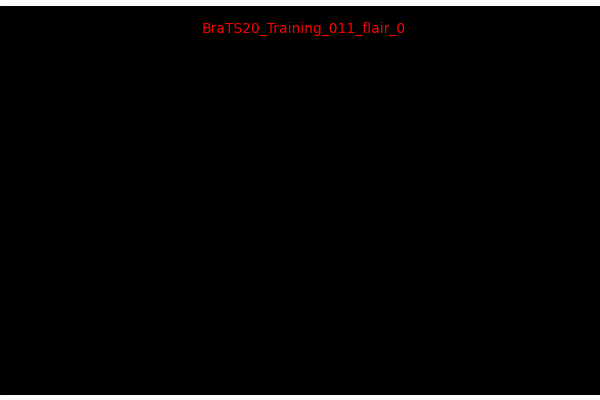

In [ ]:
import matplotlib.pyplot as plt

image = np.rot90(montage(sample_img))
mask = np.rot90(montage(sample_mask))
mask = np.clip(mask, 0, 1)

fig, ax1 = plt.subplots(1, 1, figsize = (20, 20))
ax1.imshow(image, cmap ='bone')
ax1.imshow(np.ma.masked_where(mask == False, mask),
           cmap='cool_r', alpha=0.6, animated=True)
fig.savefig(f'{label}_3d_to_2d.png', format='png', bbox_inches='tight', pad_inches=0.0)

for i in range(sample_img.shape[0]):
    image = np.rot90(sample_img[i])
    mask = np.clip(np.rot90(sample_mask[i]), 0, 1)

    # Apply the 'inferno' colormap
    image_colormap = plt.get_cmap('inferno')(image)

    sample_data_gif.add(image_colormap, mask, label=f'{label}_{str(i)}')

sample_data_gif.save(filename, fps=15)
show_gif(filename, format='png')

In [ ]:
niimg = nl.image.load_img(sample_filename)
nimask = nl.image.load_img(sample_filename_mask)

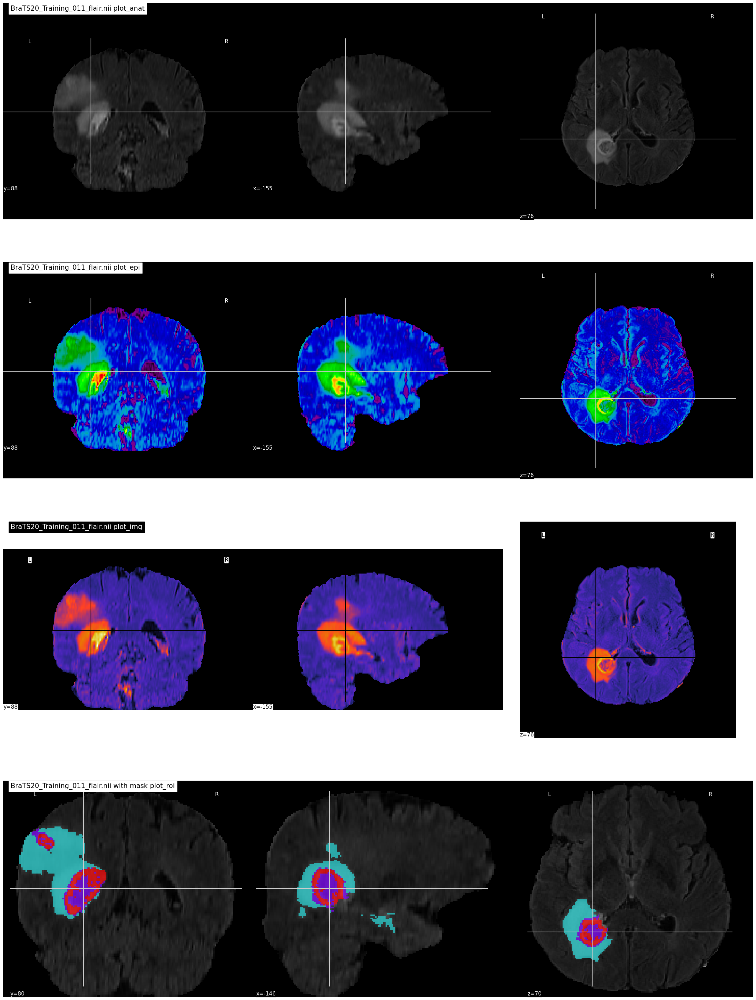

In [ ]:
fig, axes = plt.subplots(nrows=4, figsize=(30, 40))


nlplt.plot_anat(niimg,
                title='BraTS20_Training_011_flair.nii plot_anat',
                axes=axes[0])

nlplt.plot_epi(niimg,
               title='BraTS20_Training_011_flair.nii plot_epi',
               axes=axes[1])

nlplt.plot_img(niimg,
               title='BraTS20_Training_011_flair.nii plot_img',
               axes=axes[2])

nlplt.plot_roi(nimask,
               title='BraTS20_Training_011_flair.nii with mask plot_roi',
               bg_img=niimg,
               axes=axes[3], cmap='rainbow')

plt.show()

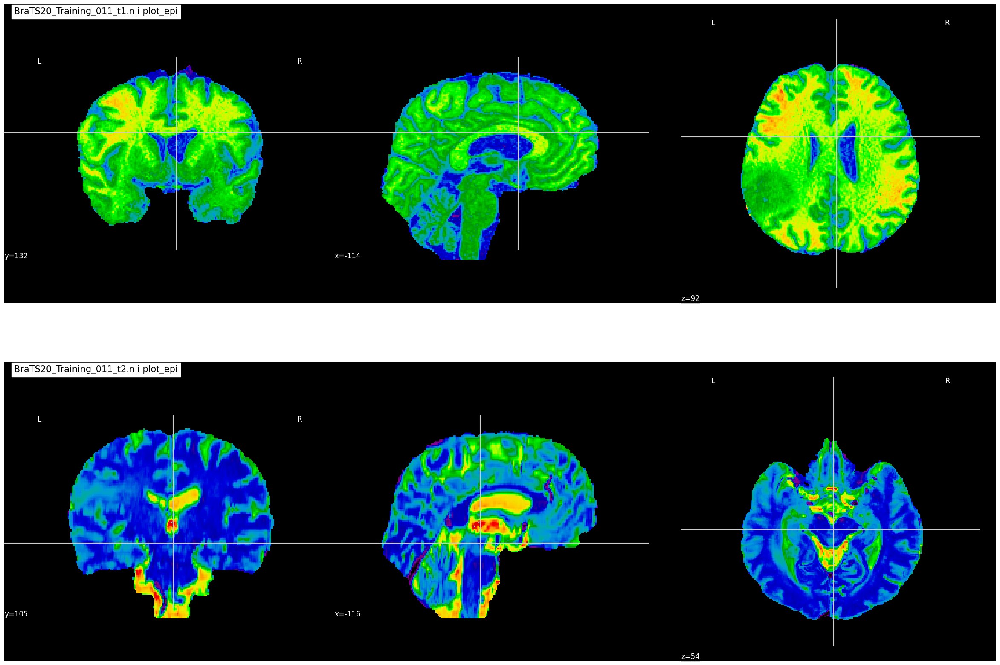

In [ ]:
t1_niimg  = nl.image.load_img('/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_011/BraTS20_Training_011_t1.nii')
t2_niimg  = nl.image.load_img('/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_011/BraTS20_Training_011_t2.nii')

fig, axes = plt.subplots(nrows=2, figsize=(30, 20))

nlplt.plot_epi(t1_niimg, title="BraTS20_Training_011_t1.nii plot_epi", axes=axes[0])
nlplt.plot_epi(t2_niimg, title="BraTS20_Training_011_t2.nii plot_epi", axes=axes[1])
plt.show()

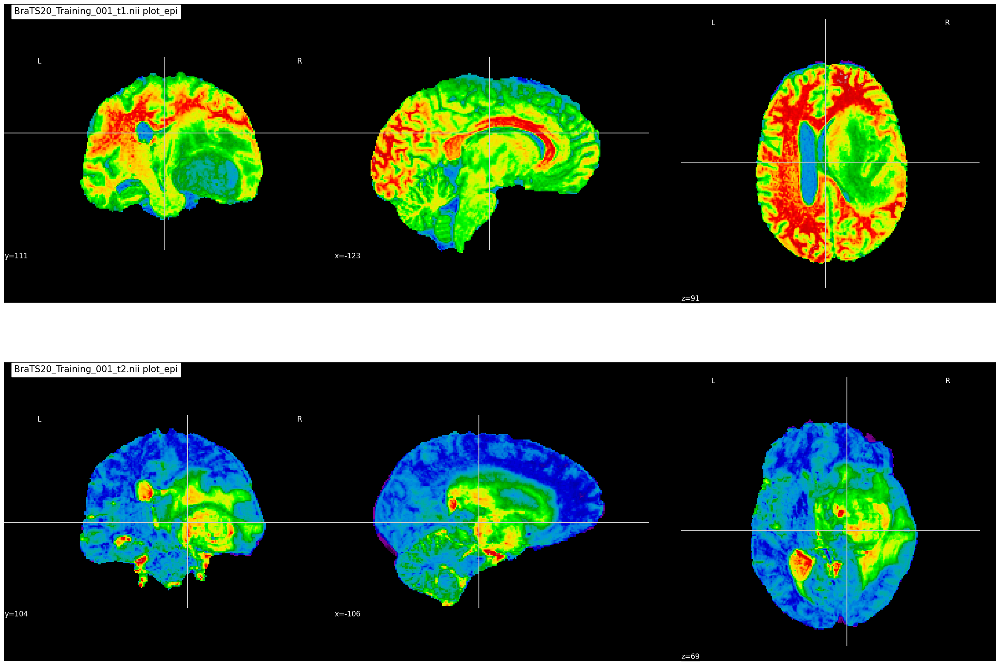

In [ ]:
t1_niimg  = nl.image.load_img('/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1.nii')
t2_niimg  = nl.image.load_img('/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t2.nii')

fig, axes = plt.subplots(nrows=2, figsize=(30, 20))

nlplt.plot_epi(t1_niimg, title="BraTS20_Training_001_t1.nii plot_epi", axes=axes[0])
nlplt.plot_epi(t2_niimg, title="BraTS20_Training_001_t2.nii plot_epi", axes=axes[1])
plt.show()

In [ ]:
!kaggle competitions download -c osic-pulmonary-fibrosis-progression

100% 13.3G/13.3G [06:02<00:00, 39.9MB/s]
100% 13.3G/13.3G [06:02<00:00, 39.5MB/s]


In [ ]:
!unzip osic-pulmonary-fibrosis-progression

Streaming output truncated to the last 5000 lines.
  inflating: train/ID00370637202296737666151/139.dcm  
  inflating: train/ID00370637202296737666151/14.dcm  
  inflating: train/ID00370637202296737666151/140.dcm  
  inflating: train/ID00370637202296737666151/141.dcm  
  inflating: train/ID00370637202296737666151/142.dcm  
  inflating: train/ID00370637202296737666151/143.dcm  
  inflating: train/ID00370637202296737666151/144.dcm  
  inflating: train/ID00370637202296737666151/145.dcm  
  inflating: train/ID00370637202296737666151/146.dcm  
  inflating: train/ID00370637202296737666151/147.dcm  
  inflating: train/ID00370637202296737666151/148.dcm  
  inflating: train/ID00370637202296737666151/149.dcm  
  inflating: train/ID00370637202296737666151/15.dcm  
  inflating: train/ID00370637202296737666151/150.dcm  
  inflating: train/ID00370637202296737666151/151.dcm  
  inflating: train/ID00370637202296737666151/152.dcm  
  inflating: train/ID00370637202296737666151/153.dcm  
  inflating: tra

# **DICOM File**

In [ ]:
sample_path = '/content/train/ID00007637202177411956430'
sample_path_files = sorted(os.listdir(sample_path), key=lambda x: int(x[:-4]))

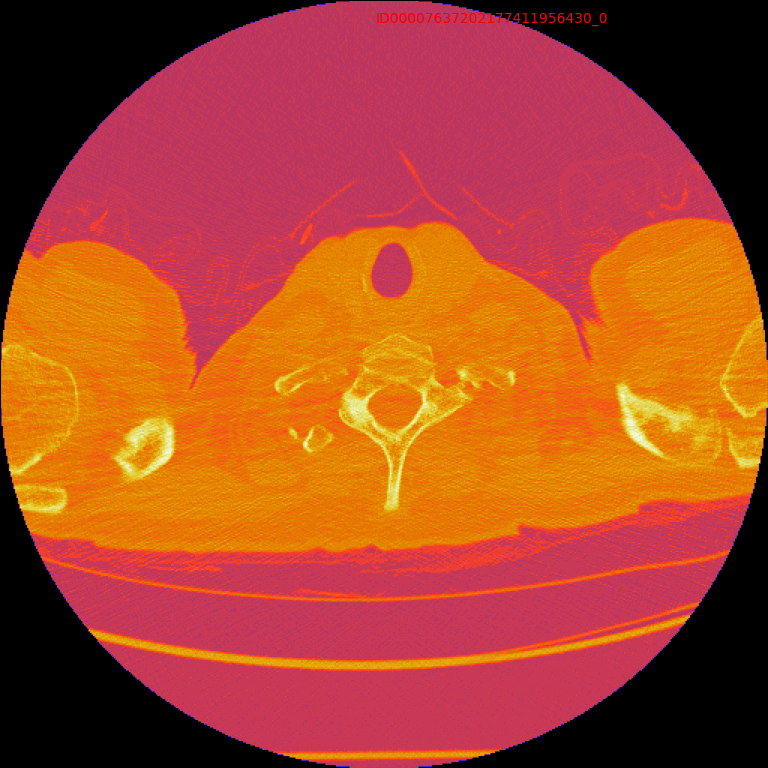

In [ ]:
sample_data_gif = ImageToGIF(size=(768, 768),
                             xy_text=(250, 15))

label = sample_path.split('/')[-1]
for i in range(len(sample_path_files)):
    path = os.path.join(sample_path, sample_path_files[i])
    image = pdm.dcmread(path).pixel_array
    sample_data_gif.add(image, label=f'{label}_{str(i)}', with_mask=False)

sample_data_gif.save(f'{label}.gif', fps=15)
show_gif(f'{label}.gif', format='png')